<h1 align="center"></h1>
<h1 align="center">Problem 1 - Building an HBM</h1>
<h2 align="center">Hierarchical Bayesian Modeling of a Single Gaussian Population with PyStan and PyJAGS</h2>
<div align="center">Simulating the distribution of "$\boldsymbol{e \cos \omega}$" for hot Jupiter exoplanets from  <i>Kepler</i>. These simulated exoplanet candiates are potentially undergoing migration and orbital circularization. </div> 
<h4 align="center">LSSTC DSFP Session 4, September 21st, 2017</h4>
<h5 align="center">Author: Megan I. Shabram, PhD, 
NASA Postdoctoral Program Fellow,  mshabram@gmail.com</h5>

In [11]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pyjags
import pystan
import pickle
import triangle_linear


from __future__ import division, print_function
from pandas.tools.plotting import *
from matplotlib import rcParams
rcParams["savefig.dpi"] = 100
rcParams["font.size"] = 20
#plt.style.use('ggplot')

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
#%qtconsole


In [12]:
## function to draw from truncated normal, this function will be used for both the 
## one- and two-componenet cases in this workbook.  

def rnorm_bound( Ndata, mu, prec, lower_bound = 0.0, upper_bound = float('Inf')):
    x = np.zeros(Ndata)
    #print(x)
    for i in range(0, Ndata): 
            #print(i)
            while True:
                x[i] = np.random.normal(mu,prec,1)
                if( (x[i]>lower_bound) and (x[i]<upper_bound) ): 
                    break
    return x;

[-0.5382794   0.290208    0.31050348  0.12627965  0.77491192  0.16464557
  0.04005258  0.10395082  0.24625225 -0.00614552 -0.47531384 -0.05637979
  0.2231899  -0.12774454 -0.7236663   0.41392088  0.14805332  0.68627009
 -0.03329833 -0.80652606] [ -5.45935986e-01   2.68347112e-01   3.50568203e-01   1.94683305e-01
   7.01145768e-01   1.89927161e-01   4.58639581e-02   1.09202451e-01
   2.56105236e-01   9.13607417e-02  -4.39436920e-01  -3.03361200e-04
   2.93342655e-01  -1.90833391e-01  -7.39845175e-01   3.12154112e-01
   1.28667885e-01   7.66958885e-01  -4.40998755e-02  -8.26101114e-01]


(array([ 2.,  1.,  1.,  1.,  1.,  5.,  4.,  3.,  0.,  2.]),
 array([-0.82610111, -0.66679511, -0.50748911, -0.34818311, -0.18887711,
        -0.02957111,  0.12973489,  0.28904089,  0.44834689,  0.60765288,
         0.76695888]),
 <a list of 10 Patch objects>)

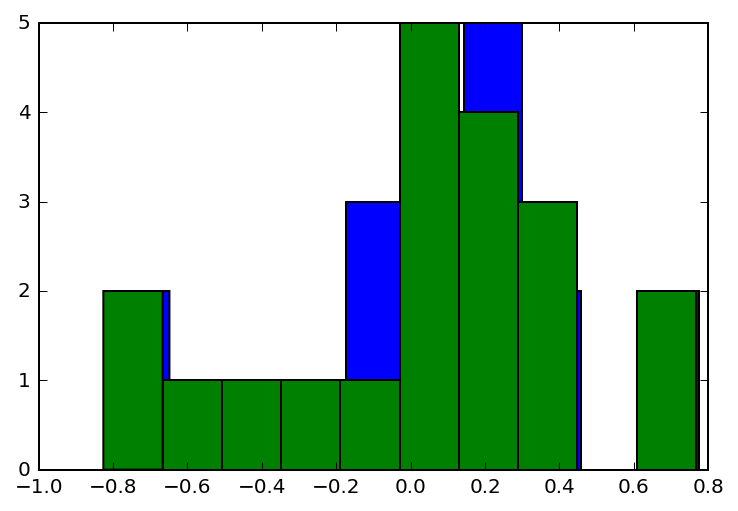

In [13]:
## One-component Gaussian Mixture Simulated Data
## Below we designate the population values of our generative model. These are the 
## truths that we should recover if our hiararchical Bayesian model is properly specified 
## and diagnostics have indicated that the simulation has "not not converged". "You can't 
## prove convergence, at best you can fail to prove a failure to converge".

## In this simulated data set, their are 50 planetary systems (with one planet each)
Ndata = 20 
## Here we asign the dispersion of the simulated population to be 0.3, this is 
## the truth we wish to recovern 
sigmae = 0.3 
## We approximate the uncertainty for each measurement as normally distributed about a 
## reporte measurement point estimate.  For the eccentricity distribution for Hot Jupiter
## the physical models used to derive these produce larger uncertainty in k by a factor of 2. 
sigmahobs = 0.04

h = np.repeat(0.,Ndata)
hhat = np.repeat(0.,Ndata)
hhat_sigma  = np.repeat(sigmahobs,Ndata)

#print(khat_sigma)


for i in range(0,Ndata):
    h[i] = rnorm_bound(1,0,sigmae,lower_bound=-1,upper_bound=1)
    hhat[i] = rnorm_bound(1,h[i],sigmahobs,lower_bound=-1,upper_bound=1)

## Vizualize the true data values, and the simulated measurements:     
print(h, hhat)
plt.hist(h)
plt.hist(hhat)

In [14]:
eccmodel = """
data {
    int<lower=1> Ndata;
    real<lower=-1,upper=1> hhat[Ndata];
    real<lower=0,upper=1> hhat_sigma[Ndata];
}
parameters {
    real<lower=0> e_sigma;
    real<lower=-1,upper=1> h[Ndata];
}
model {

    e_sigma ~ uniform(0, 1.0);
    
    for (n in 1:Ndata)
      hhat[n] ~ normal(h[n], hhat_sigma[n]);
    
    for (n in 1:Ndata)
      increment_log_prob(normal_log(h[n], 0.0, e_sigma));
}
"""
# Compiled Stan Model
sm = pystan.StanModel(model_code=eccmodel)

In [15]:
ecc_dat = {'Ndata': len(hhat), 'hhat': hhat, 'hhat_sigma': hhat_sigma}


fit = sm.sampling(data=ecc_dat, iter=10000, chains=4, seed=483892929, refresh=1000, n_jobs=-1)



//anaconda/lib/python2.7/multiprocessing/queues.py:392: UserWarning: Pickling fit objects is an experimental feature!
The relevant StanModel instance must be pickled along with this fit object.
When unpickling the StanModel must be unpickled first.
  return send(obj)
//anaconda/lib/python2.7/multiprocessing/queues.py:392: UserWarning: Pickling fit objects is an experimental feature!
The relevant StanModel instance must be pickled along with this fit object.
When unpickling the StanModel must be unpickled first.
  return send(obj)
//anaconda/lib/python2.7/multiprocessing/queues.py:392: UserWarning: Pickling fit objects is an experimental feature!
The relevant StanModel instance must be pickled along with this fit object.
When unpickling the StanModel must be unpickled first.
  return send(obj)
//anaconda/lib/python2.7/multiprocessing/queues.py:392: UserWarning: Pickling fit objects is an experimental feature!
The relevant StanModel instance must be pickled along with this fit object.
Wh

In [16]:
print(fit)

Inference for Stan model: anon_model_438b4e266a27bc779461f05007a9a701.
4 chains, each with iter=10000; warmup=5000; thin=1; 
post-warmup draws per chain=5000, total post-warmup draws=20000.

          mean se_mean     sd   2.5%    25%    50%    75%  97.5%  n_eff   Rhat
e_sigma   0.44  5.3e-4   0.08   0.32   0.38   0.43   0.48   0.61  20000    1.0
h[0]     -0.54  2.8e-4   0.04  -0.62  -0.57  -0.54  -0.51  -0.46  20000    1.0
h[1]      0.27  2.8e-4   0.04   0.19   0.24   0.27   0.29   0.34  20000    1.0
h[2]      0.35  2.8e-4   0.04   0.27   0.32   0.35   0.37   0.43  20000    1.0
h[3]      0.19  2.9e-4   0.04   0.11   0.17   0.19   0.22   0.27  20000    1.0
h[4]      0.69  2.8e-4   0.04   0.62   0.67   0.69   0.72   0.77  20000    1.0
h[5]      0.19  2.9e-4   0.04   0.11   0.16   0.19   0.22   0.27  20000    1.0
h[6]      0.05  2.9e-4   0.04  -0.03   0.02   0.05   0.07   0.13  20000    1.0
h[7]      0.11  2.8e-4   0.04   0.03   0.08   0.11   0.14   0.19  20000    1.0
h[8]      0.25  2.8

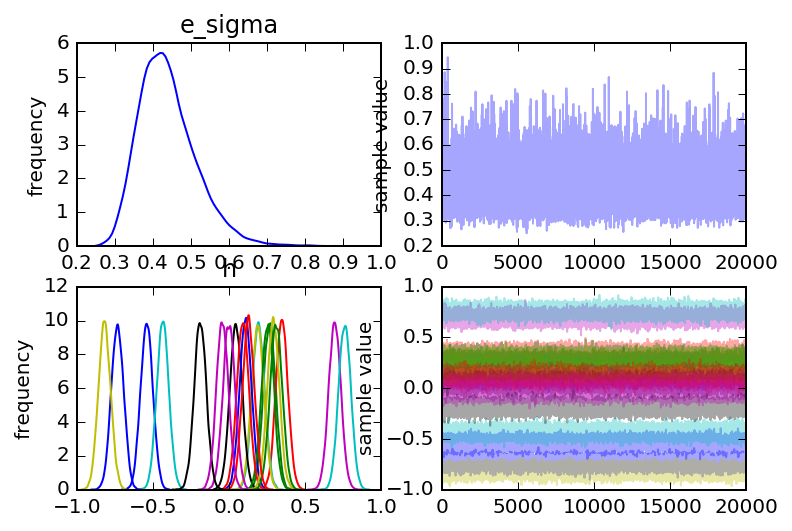

In [17]:
fig = fit.traceplot()

In [18]:
la = fit.extract(permuted=True)  # return a dictionary of arrays

a = fit.extract(permuted=False)

e_sigma = la['e_sigma'].reshape(4,5000)
print(e_sigma.shape)
#print(la.shape)
#print(e_sigma.reshape(4,5000))

(4, 5000)


In [19]:
num_chains = 4

df = pd.DataFrame(la.items())
print(df)
print(df.keys())
samples_Stan = dict(zip(df[0], df[1].values ))
#print(samples.items())
print(type(samples_Stan['e_sigma']))
print(samples_Stan.items())
#for j, i in samples.items():
#    print(j)
#    print(i.shape)

         0                                                  1
0  e_sigma  [0.590621105194, 0.456659684456, 0.46576878352...
1        h  [[-0.498600954502, 0.18066271554, 0.3503271899...
2     lp__  [-40.5994053564, -41.0876531437, -38.666617351...
RangeIndex(start=0, stop=2, step=1)
<type 'numpy.ndarray'>
[(u'h', array([[-0.49860095,  0.18066272,  0.35032719, ...,  0.78359789,
        -0.09057801, -0.80347499],
       [-0.52546475,  0.23089041,  0.36838039, ...,  0.74545023,
        -0.02915871, -0.72241407],
       [-0.55629287,  0.22783052,  0.27499614, ...,  0.77548701,
        -0.03017015, -0.779118  ],
       ..., 
       [-0.50430081,  0.27171718,  0.30945146, ...,  0.77096973,
        -0.06305208, -0.80844996],
       [-0.61410749,  0.14312466,  0.32045394, ...,  0.84301352,
        -0.10175334, -0.77809324],
       [-0.58655235,  0.20690498,  0.35230714, ...,  0.7170671 ,
        -0.03528434, -0.81185567]])), (u'lp__', array([-40.59940536, -41.08765314, -38.66661735, ..., -39.0

In [20]:

## Print and check the shape of the resultant samples dictionary:
#print(samples)
#print(samples.items())
print('-----')
print(samples_Stan['e_sigma'].shape)
print(samples_Stan['h'].shape)
print(samples_Stan['h'][:,3].shape)
print('-----')


## Update the samples dictionary so that it includes keys for the latent variables
## Also, we will use LaTeX formatting to help make legible plots ahead.  
samples_Nm1_Stan = {}

## adjust the thin varible to only look at every #th population element 
thin1 = 1

## Need to enter the number of hyperparameter variables here:
numHyperParams = 1

## Specify the dimension we want for our plot below, for legibility.  
dim1 = (Ndata/thin1) + numHyperParams
print(dim1)

for i in np.arange(0,Ndata,thin1):
    samples_Nm1_Stan.update({'$h_{'+str(i+1)+'}$': samples_Stan['h'][:,i]})

## Add the hyperparameter marginal posterior back in:
samples_Nm1_Stan.update({'$e_{\sigma}$': samples_Stan['e_sigma']})
print(samples_Nm1_Stan['$h_{5}$'].shape)

## Reshape values for diagnostic plot functions (trace, autocorrelation) below:  
samples_Nm1_trace_Stan = {}    
for j, i in samples_Nm1_Stan.items():
    samples_Nm1_trace_Stan.update({str(j): i.reshape(int(len(i)/num_chains),-1)})




-----
(20000,)
(20000, 20)
(20000,)
-----
21.0
(20000,)


In [21]:
## equal tailed 95% credible intervals, and posterior distribution means:
def summary(samples, varname, p=95):
    values = samples[varname][0]
    ci = np.percentile(values, [100-p, p])
    print('{:<6} mean = {:>5.1f}, {}% credible interval [{:>4.1f} {:>4.1f}]'.format(
      varname, np.mean(values), p, *ci))

for varname in samples_Nm1_trace_Stan:
    summary(samples_Nm1_trace_Stan, varname)


$h_{2}$ mean =   0.2, 95% credible interval [ 0.2  0.3]
$h_{16}$ mean =   0.3, 95% credible interval [ 0.2  0.3]
$h_{4}$ mean =   0.2, 95% credible interval [ 0.2  0.2]
$h_{9}$ mean =   0.2, 95% credible interval [ 0.2  0.3]
$h_{6}$ mean =   0.2, 95% credible interval [ 0.2  0.2]
$h_{3}$ mean =   0.3, 95% credible interval [ 0.3  0.4]
$h_{14}$ mean =  -0.2, 95% credible interval [-0.2 -0.2]
$h_{20}$ mean =  -0.8, 95% credible interval [-0.8 -0.7]
$h_{7}$ mean =   0.1, 95% credible interval [ 0.0  0.1]
$h_{10}$ mean =   0.1, 95% credible interval [ 0.0  0.1]
$h_{1}$ mean =  -0.5, 95% credible interval [-0.6 -0.5]
$h_{15}$ mean =  -0.7, 95% credible interval [-0.8 -0.7]
$h_{17}$ mean =   0.1, 95% credible interval [ 0.1  0.2]
$h_{5}$ mean =   0.7, 95% credible interval [ 0.7  0.7]
$h_{13}$ mean =   0.3, 95% credible interval [ 0.3  0.3]
$h_{18}$ mean =   0.8, 95% credible interval [ 0.7  0.8]
$h_{8}$ mean =   0.1, 95% credible interval [ 0.1  0.1]
$h_{19}$ mean =  -0.0, 95% credible inte

Variable
$e_{\sigma}$    0.438685
$h_{10}$        0.090735
$h_{11}$       -0.435306
$h_{12}$       -0.000378
$h_{13}$        0.290781
$h_{14}$       -0.189410
$h_{15}$       -0.733445
$h_{16}$        0.309494
$h_{17}$        0.127521
$h_{18}$        0.759998
$h_{19}$       -0.044003
$h_{1}$        -0.540997
$h_{20}$       -0.818333
$h_{2}$         0.265957
$h_{3}$         0.347456
$h_{4}$         0.193082
$h_{5}$         0.694698
$h_{6}$         0.188397
$h_{7}$         0.045704
$h_{8}$         0.108574
$h_{9}$         0.254458
dtype: float64
Variable  $e_{\sigma}$  $h_{10}$  $h_{11}$  $h_{12}$  $h_{13}$  $h_{14}$  \
0.05          0.334026  0.024922 -0.500688 -0.066577  0.225308 -0.254686   
0.95          0.576375  0.156550 -0.369324  0.065542  0.355629 -0.124276   

Variable  $h_{15}$  $h_{16}$  $h_{17}$  $h_{18}$    ...      $h_{1}$  \
0.05     -0.800177  0.243215  0.062364  0.693953    ...    -0.606723   
0.95     -0.667042  0.375089  0.193023  0.825825    ...    -0.474883   

Varia

//anaconda/lib/python2.7/site-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


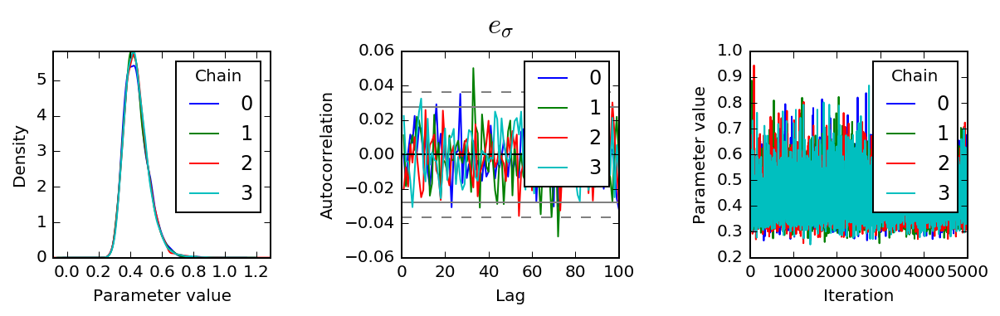

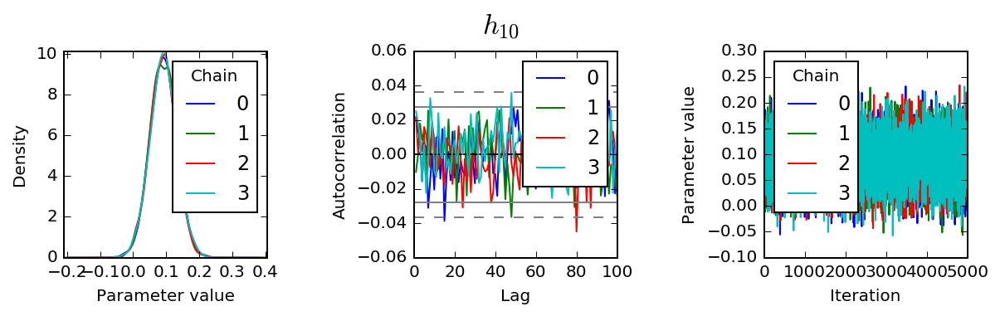

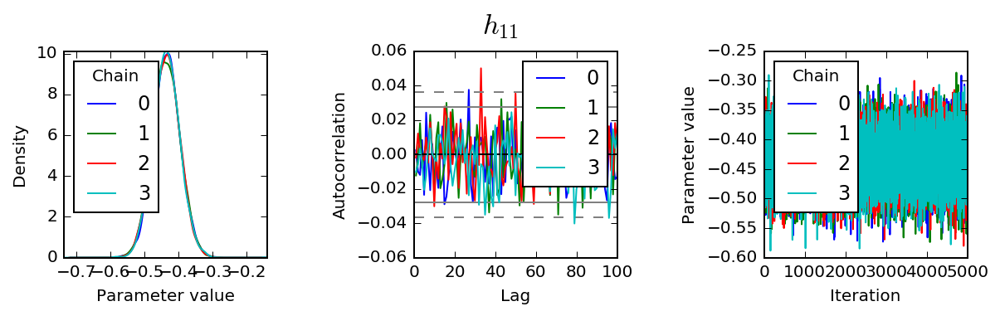

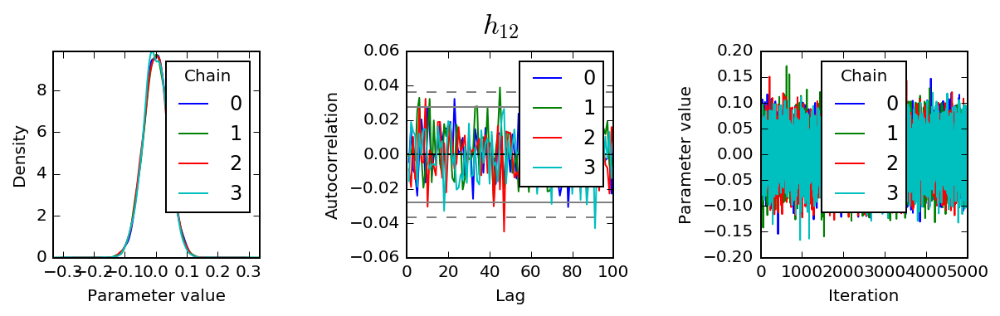

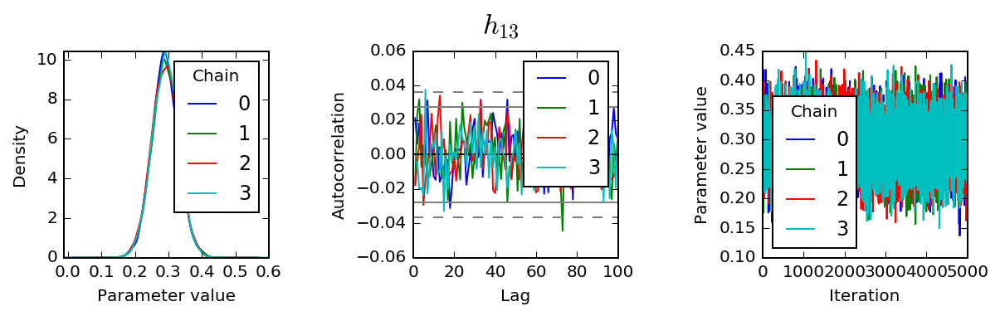

...

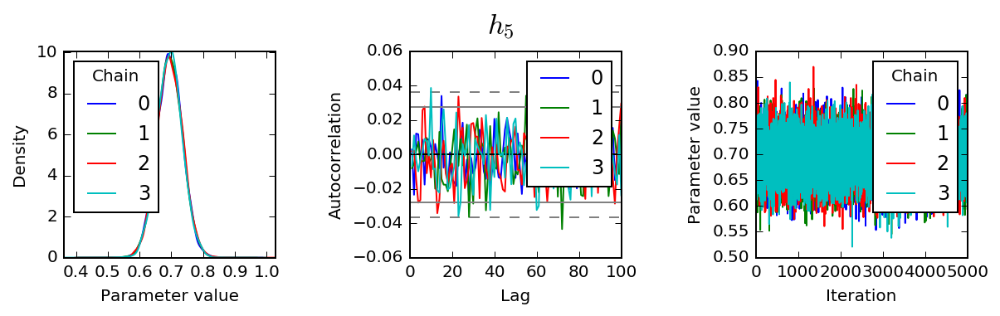

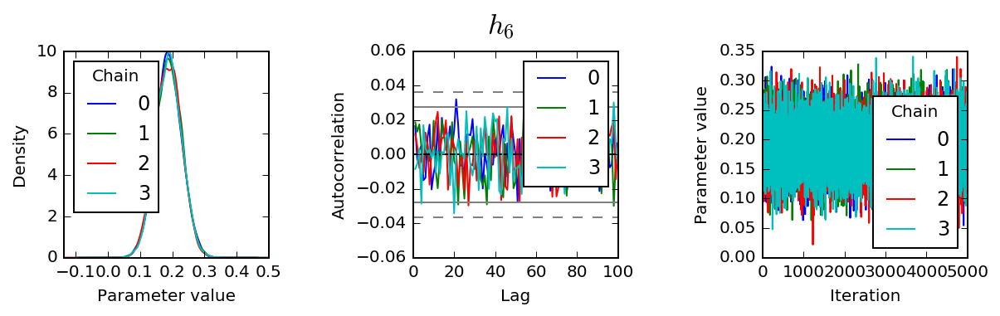

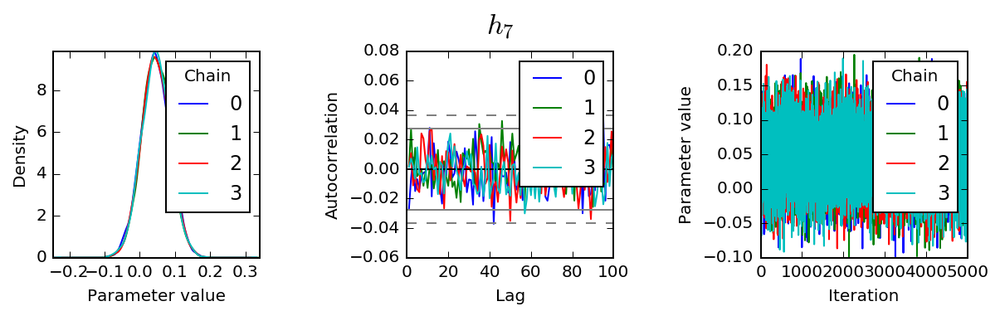

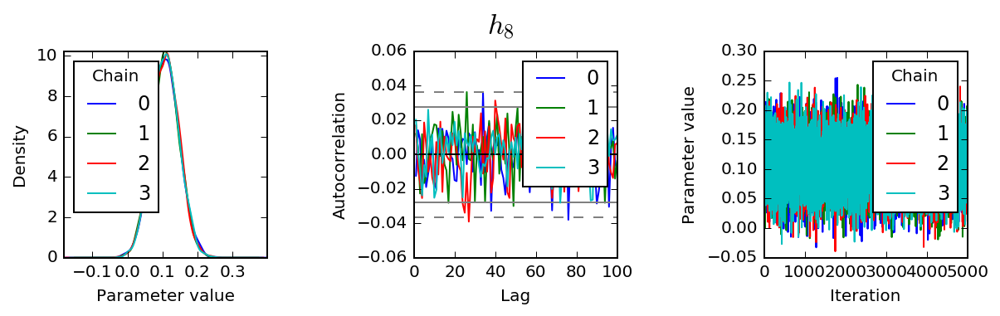

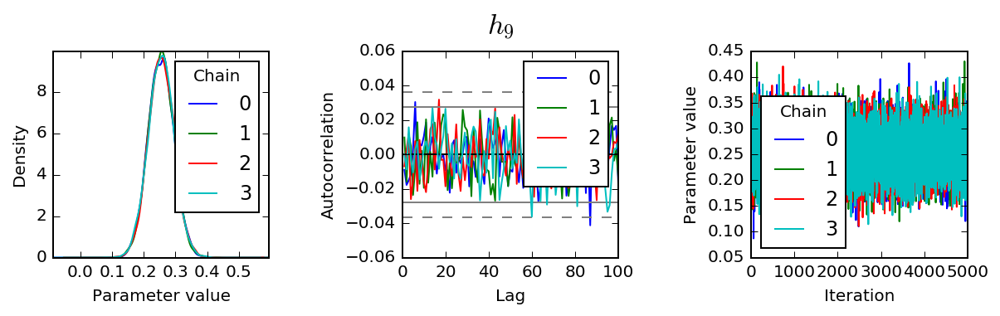

In [22]:
## Use pandas three dimensional Panel to represent the trace:

trace_1_Stan = pd.Panel({k: v for k, v in samples_Nm1_trace_Stan.items()})
trace_1_Stan.axes[0].name = 'Variable'
trace_1_Stan.axes[1].name = 'Iteration'
trace_1_Stan.axes[2].name = 'Chain'
 
## Point estimates:
print(trace_1_Stan.to_frame().mean())
 
## Bayesian equal-tailed 95% credible intervals:
print(trace_1_Stan.to_frame().quantile([0.05, 0.95]))
  ## ^ entering the values here could be a good question part
    
def plot(trace, var):
    fig, axes = plt.subplots(1, 3, figsize=(9, 3))
    fig.suptitle(var, y=0.95, fontsize='xx-large')
 
    ## Marginal posterior density estimate:
    trace[var].plot.density(ax=axes[0])
    axes[0].set_xlabel('Parameter value')
    axes[0].locator_params(tight=True)
 
    ## Autocorrelation for each chain:
    axes[1].set_xlim(0, 100)
    for chain in trace[var].columns:
        autocorrelation_plot(trace[var,:,chain], axes[1], label=chain)
 
    ## Trace plot:
    axes[2].set_ylabel('Parameter value')
    trace[var].plot(ax=axes[2])
 
    ## Save figure
    filename = var.replace("\\", "") 
    filename = filename.replace("$", "") 
    filename = filename.replace("}", "") 
    filename = filename.replace("{", "") 
    plt.tight_layout(pad=3)
    fig.savefig('/Users/meganshabram/Dropbox/NASA_Postdoctoral_Program_Fellowship/LSSTC DSFP Session 4 Workshop/Plots2/Nm1_Stan/Nm1_'+'{}.png'.format(filename))
 
# Display diagnostic plots
for var in trace_1_Stan:
    plot(trace_1_Stan, var)
 


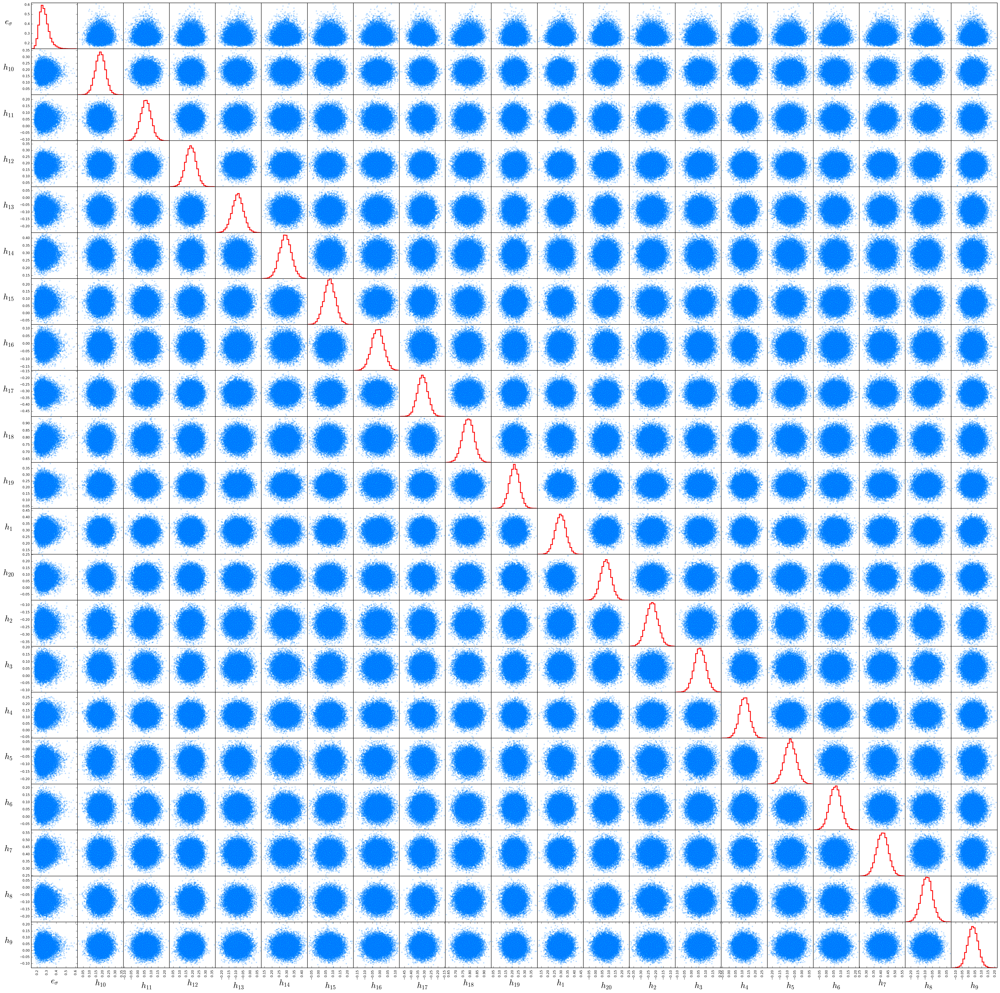

In [34]:
## Scatter matrix plot:
##    If Ndata is increase, this scatter_matrix might do better to skip every nth latent variable
##    Code for that is in a future code cell, where we make a triangle plot with KDE for 
##    joint 2D marginals. scatter_matrix is a Python Pandas module.

sm = scatter_matrix(trace_1_Stan.to_frame(),  color="#00BFFF", alpha=0.2, figsize=(dim1*2, dim1*2), diagonal='hist',hist_kwds={'bins':25,'histtype':'step', 'edgecolor':'r','linewidth':2})

## y labels size
[plt.setp(item.yaxis.get_label(), 'size', 20) for item in sm.ravel()]

## x labels size 
[plt.setp(item.xaxis.get_label(), 'size', 20) for item in sm.ravel()]

## Change label rotation.  This is helpful for very long labels
#[s.xaxis.label.set_rotation(45) for s in sm.reshape(-1)]

[s.xaxis.label.set_rotation(0) for s in sm.reshape(-1)]
[s.yaxis.label.set_rotation(0) for s in sm.reshape(-1)]

## May need to offset label when rotating to prevent overlap of figure
[s.get_yaxis().set_label_coords(-0.5,0.5) for s in sm.reshape(-1)]

## Hide all ticks
#[s.set_xticks(()) for s in sm.reshape(-1)]
#[s.set_yticks(()) for s in sm.reshape(-1)]

## Save the figure as .png 
plt.savefig('/Users/meganshabram/Dropbox/NASA_Postdoctoral_Program_Fellowship/LSSTC DSFP Session 4 Workshop/Plots2/scatter_matrix_Nm1_Stan.png')


In [35]:

## Redefine the trace so that we only vizualize every #th latent variable element in 
## the scatter_matrix plot below. Vizualizing all Ndata is too cumbersome for the scatter
## matrix. 

## adjust the thin varible to only look at every #th population element 
thin = 4

## Re-specify the dimension we want for our plot below, with thinning, for legibility.  
dim2 = (Ndata/thin) + numHyperParams
print(dim2)

samples_Nm1_triangle_1_Stan = {}
truths_hhat = {}
truths_h = {}
for i in np.arange(0,Ndata,thin):
    samples_Nm1_triangle_1_Stan.update({'$h_{'+str(i+1)+'}$': samples_Stan['h'][:,i]})
    truths_hhat.update({'$h_{'+str(i+1)+'}$': hhat[i]})
    truths_h.update({'$h_{'+str(i+1)+'}$': h[i]})
samples_Nm1_triangle_1_Stan.update({'$e_{\sigma}$': samples_Stan['e_sigma']})
truths_hhat.update({'$e_{\sigma}$': sigmae})
truths_h.update({'$e_{\sigma}$': sigmae})

## Reshape values for diagnostic plot functions (trace, autocorrelation, scatter_matrix):  
#samples_Nm1_triangle_trace_Stan = {}    
#for j, i in samples_Nm1_triangle_Stan.items():
#    samples_Nm1_triangle_trace_Stan.update({str(j): i.reshape(int(len(i)/num_chains),-1)})
#
#print(list(samples_Nm1_scatter_matrix_trace.items()))
#print(list(samples_Nm1_scatter_matrix_trace['$h_{6}$'][0]))



6.0


In [38]:
#trace_2.to_frame()
print(samples_Nm1_triangle_1_Stan.keys())
print(5000*num_chains)
print(int(dim2))
print(truths_hhat.values())

['$h_{13}$', '$h_{9}$', '$e_{\\sigma}$', '$h_{1}$', '$h_{17}$', '$h_{5}$']
20000
6
[-0.089588029446661055, 0.033012524752430404, 0.3, 0.30170077192407163, -0.32152838285460988, -0.081749787467882459]


(20000, 6)


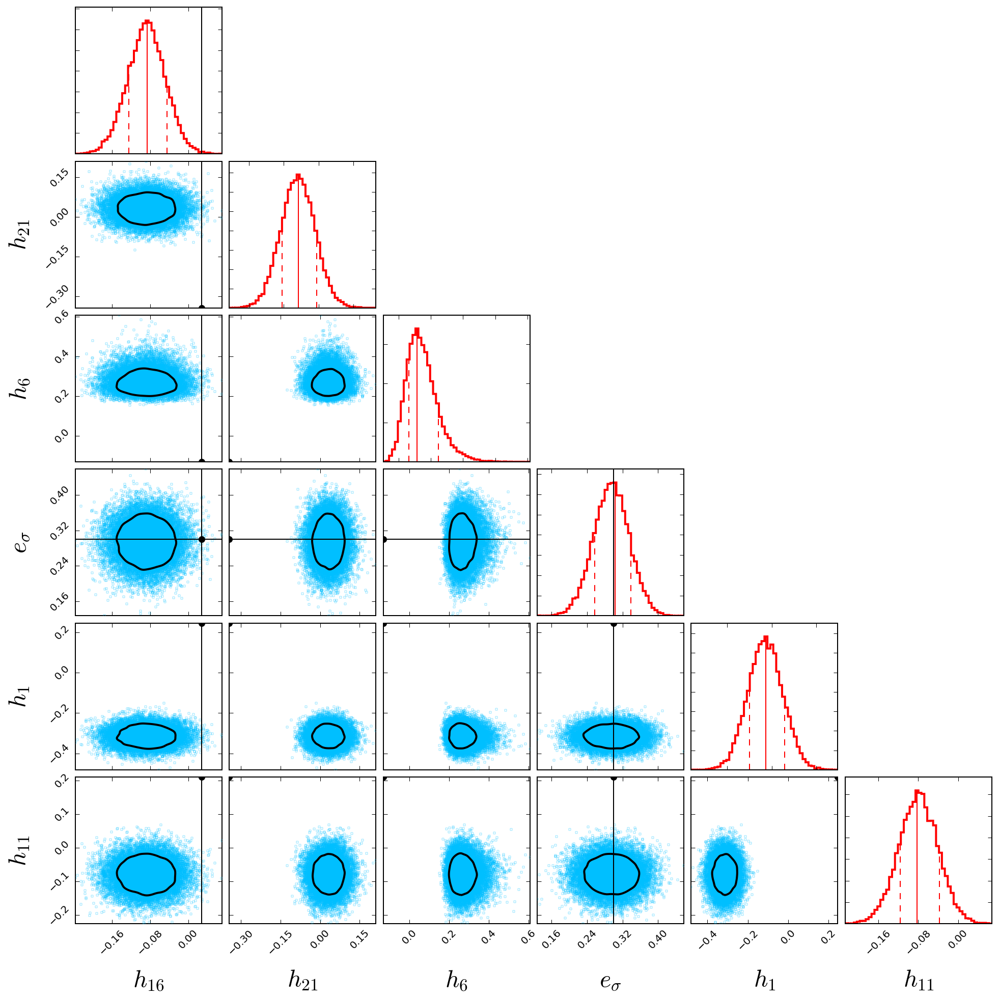

In [37]:

#data = np.asarray(samples_Nm1_scatter_matrix_triangle.values()).reshape((5000*num_chains),int(dim2))
#print(np.asarray(samples_Nm1_scatter_matrix_triangle.values()).reshape((5000*num_chains),int(dim2)).shape)

samples_Nm1_triangle_2_Stan = {}    
for j, i in samples_Nm1_triangle_1_Stan.items():
    samples_Nm1_triangle_2_Stan.update({str(j): i.reshape(-1,1)})
    
data = None
for k, v in samples_Nm1_triangle_2_Stan.items():
    column = v.reshape(-1,1)
    if data is None:
        data = column
    else:
        data = np.hstack((data, column))

print(data.shape)

figure = triangle_linear.corner(data,labels=samples_Nm1_triangle_2_Stan.keys(),labelsy=samples_Nm1_triangle_2_Stan.keys(), truths=truths_hhat.values(), truths_color = 'black')

plt.savefig('/Users/meganshabram/Dropbox/NASA_Postdoctoral_Program_Fellowship/LSSTC DSFP Session 4 Workshop/Plots2/triangle_linear_Nm1_Stan.png')


In [9]:
from IPython.display import display, Math, Latex
display(Math(r'\sqrt{a^2 + b^2}')) 



<IPython.core.display.Math object>

$$c = \sqrt{a^2 + b^2}$$

TO DO
    - [DONE!] get dataframe working properly, try pandas?
    - look at output more, explore shrinkage? 
    - explore draws from the posterior plotted as normals on top of data
    - explore an NM2 model in the framework on an Nm1 analysis
    - What happens when you inrease the fractional uncertainty?, what may solve this?
    - third notebook with breakpoint model? eclipsing binary data that is real? (dont save posteriors for each latent value here).  
    - plot truths in scatter plot? plot truths on histograms 
    - separete missing autocorrelation plots here. 
    - Truths, h or hhat?